In [1]:
%pip install snntorch

Note: you may need to restart the kernel to use updated packages.


# Caricamento del dataset FashionMNIST
Viene caricato il dataset di test per fare delle elaborazioni

In [2]:
import torchvision
from torchvision import datasets

# definizione della cartella in cui scaricare i dati
data_root = "../data"

# definizione del train dataset FashionMNIST e delle trasformazioni da applicare 
# fmnist_trainset = datasets.FashionMNIST(root=data_root, train=True, download=True, transform=None)
# definizione del test dataset FashionMNIST e delle trasformazioni da applicare
transform=torchvision.transforms.Compose([
    torchvision.transforms.Resize((28,28)),
    torchvision.transforms.Grayscale(),
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize((0.,),(1.,))
])

fmnist_testset = datasets.FashionMNIST(root=data_root, train=False, download=True, transform=transform)

# Caricamento dei moduli e delle classi

In [3]:
import ipywidgets as widgets
import torch
import snntorch as snn
from snntorch import spikegen
import matplotlib
from matplotlib import pyplot as plt
from snntorch import spikeplot as splt
from IPython.display import HTML
from torch.utils.data import DataLoader

num_steps=200
font = {
    'size': 18
}
matplotlib.rc('font', **font)

# Definizione delle etichette

In [4]:

target_label = {
    0: 'T-shirt/top',
    1: 'Trouser',
    2: 'Pullover',
    3: 'Dress',
    4: 'Coat',
    5: 'Sandal',
    6: 'Shirt',
    7: 'Sneaker',
    8: 'Bag',
    9: 'Ankle boot'
}

# Definizione del Modulo
Il modulo torch definito per elaborare i dati trasormati in spikes

In [5]:
class STModule(torch.nn.Module):
    def __init__(self, beta=0.1):
        super().__init__()
        self.lif1 = snn.Leaky(beta)

    def forward(self, data):
        mem1 = self.lif1.init_leaky()
        spike1 = data
        mem_out = []

        for step in torch.arange(0,num_steps):
            spike1[step], mem1 = self.lif1(spike1[step], mem1)
            mem_out.append(mem1)

        return spike1, torch.stack(mem_out)

In [6]:
fmnist_test_loader = DataLoader(fmnist_testset, 10)
dataset, target = next(iter(fmnist_test_loader))

## Generazione dei dati dal gruppo estratto dal dataset 

In [7]:
spike_data = spikegen.rate(dataset, num_steps=num_steps)

## Inizializzazione del Modulo

In [8]:
mod = STModule()
spike1, mem1 = mod(spike_data.clone())

# Rappresentazione del Potenziale di membrana

## Video

Ankle boot


Pullover


Trouser


Trouser


Shirt


Trouser


Coat


Shirt


Sandal


Sneaker


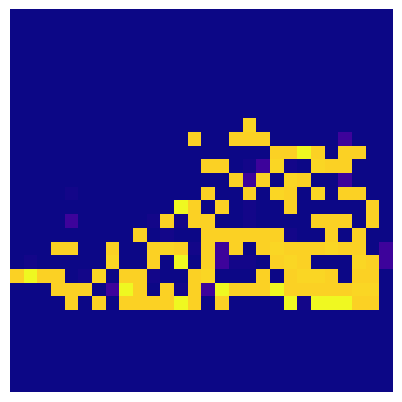

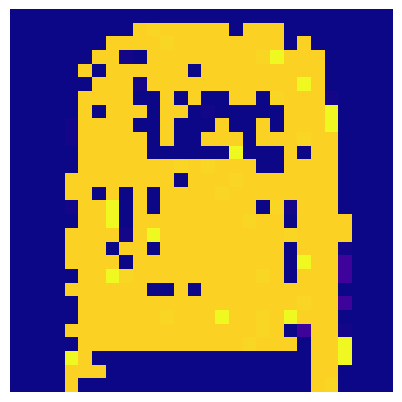

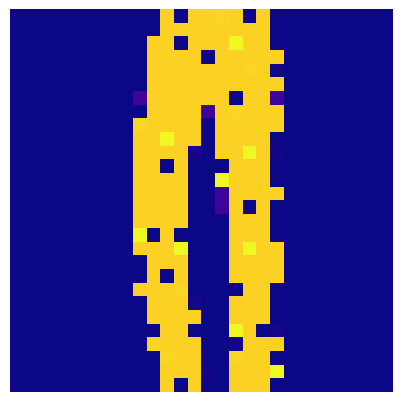

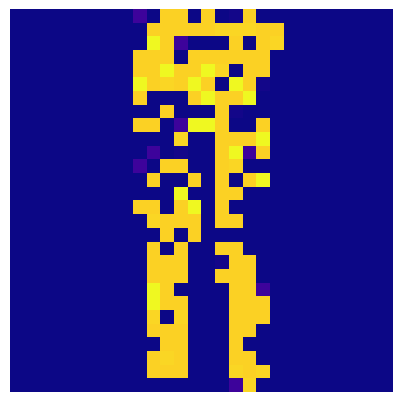

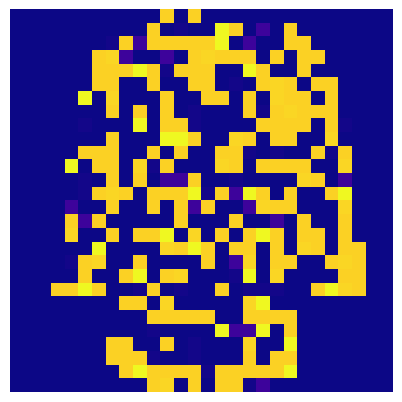

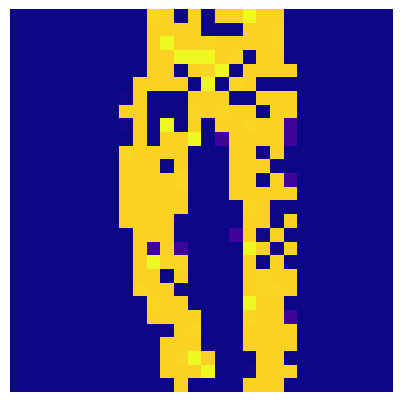

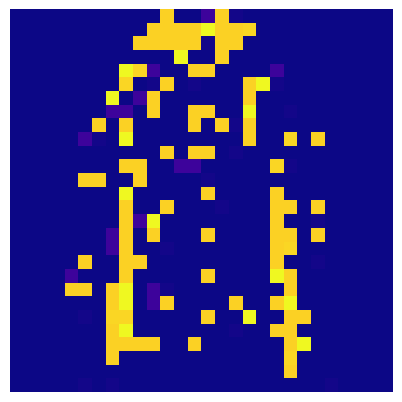

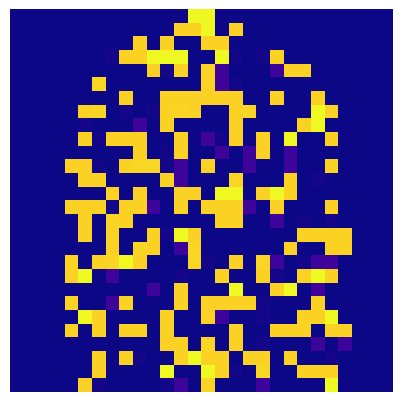

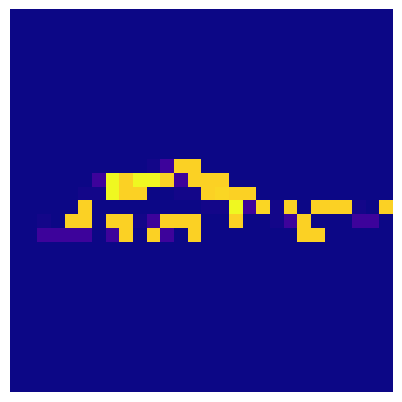

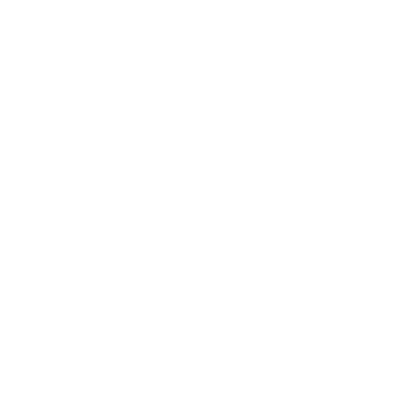

In [9]:
for i in range(0, 10):
    datapoint = mem1[:,i]
    print(target_label[target[i].item()])
    fig, ax = plt.subplots()
    fig.tight_layout()
    anim = splt.animator(datapoint.squeeze().detach(), fig, ax)
    anim.save(
        "../videos/rate-coding-FMNIST-membrane-output-video-{}.mp4".format(
            target_label[target[i].item()].lower().replace(' ', '-')
        )
    )
    display( HTML( anim.to_html5_video() ) )

## Grafici dell'uscita del potenziale di membrana

### Pixel scelti

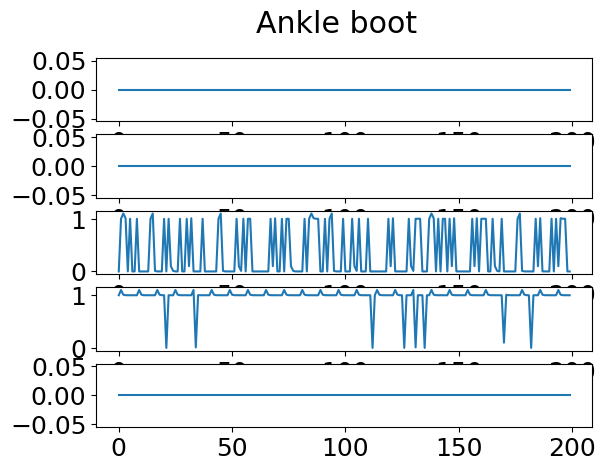

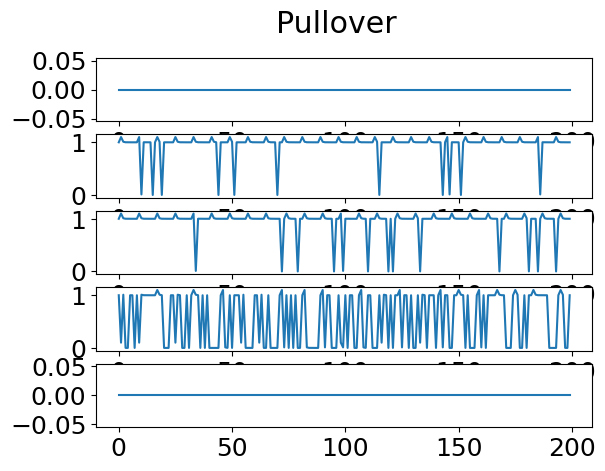

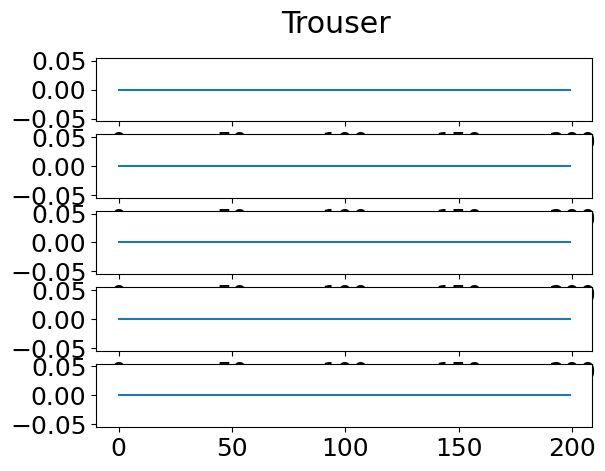

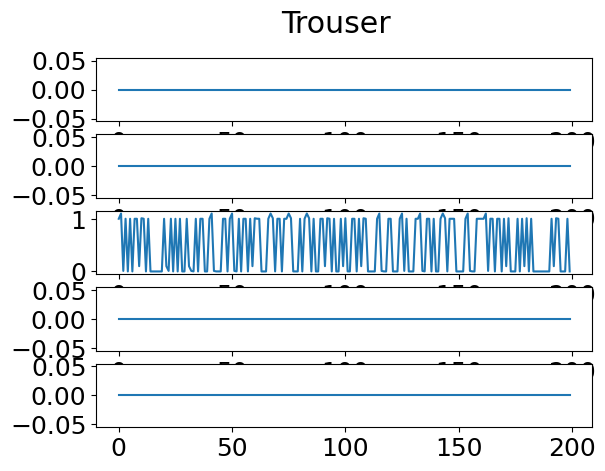

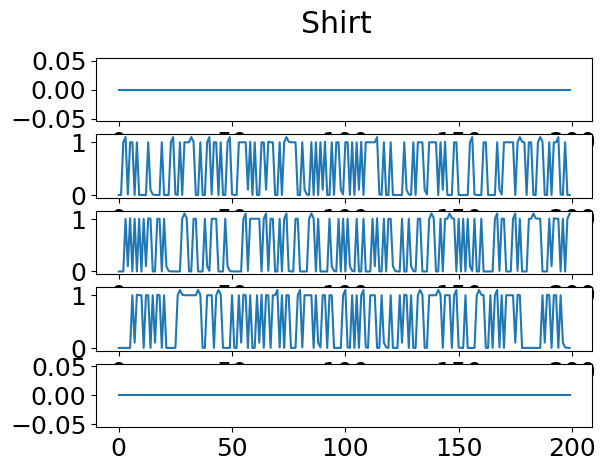

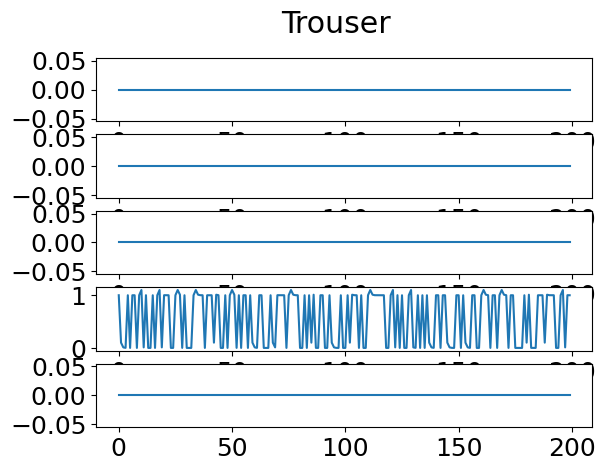

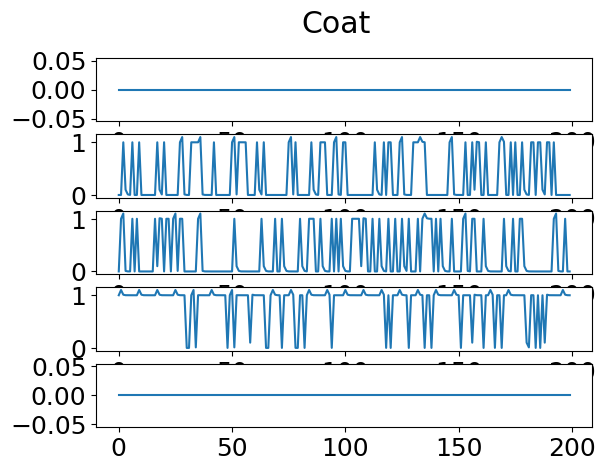

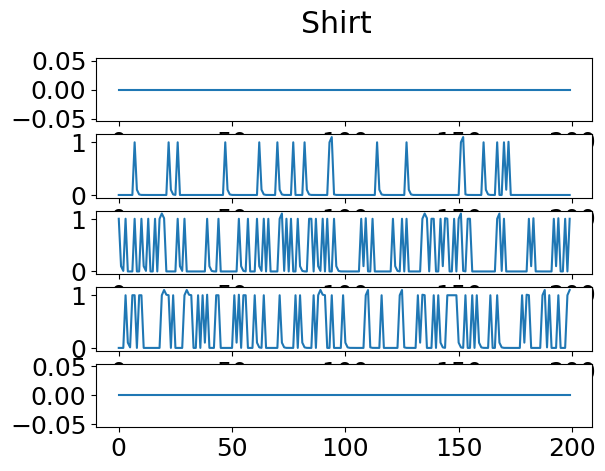

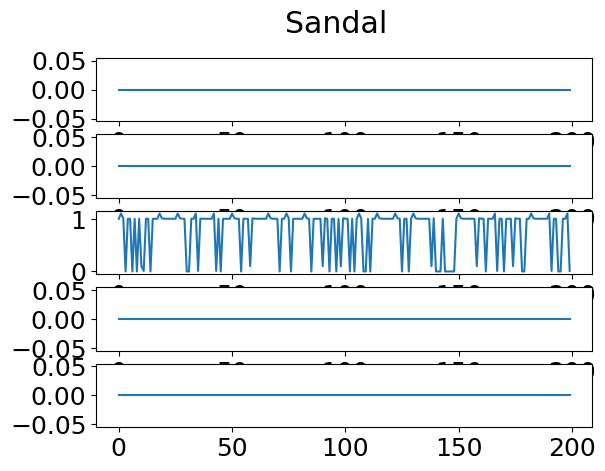

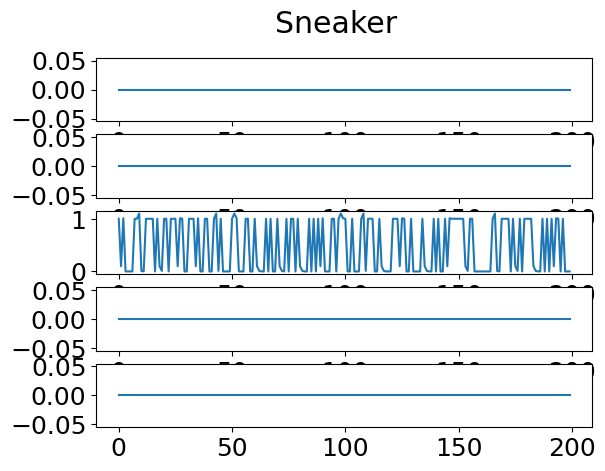

In [10]:
for i in range(0,10):
    datapoint = mem1[:,i]
    fig, axs = plt.subplots(nrows=5)
    fig.suptitle(target_label[target[i].item()])
    axs[0].plot(torch.arange(0,num_steps), datapoint.squeeze()[:,0,0].detach())
    axs[1].plot(torch.arange(0,num_steps), datapoint.squeeze()[:,6,6].detach())
    axs[2].plot(torch.arange(0,num_steps), datapoint.squeeze()[:,13,13].detach())
    axs[3].plot(torch.arange(0,num_steps), datapoint.squeeze()[:,20,20].detach())
    axs[4].plot(torch.arange(0,num_steps), datapoint.squeeze()[:,27,27].detach())
    fig.savefig(
        "../figures/rate-coding-FMNIST-membrane-output-{}.eps".format(
            target_label[target[i].item()].lower().replace(' ', '-')
        ),
        format='eps'
    )
    fig.savefig(
        "../figures/rate-coding-FMNIST-membrane-output-{}.png".format(
            target_label[target[i].item()].lower().replace(' ', '-')
        ),
        format='png'
    )
    plt.show()

### Tutti i pixel

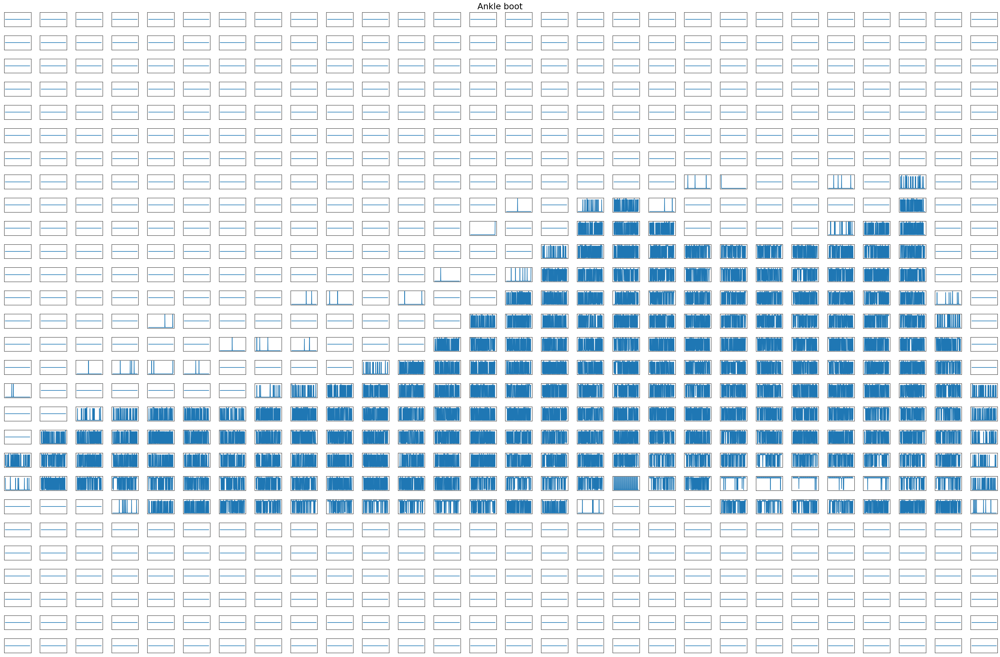

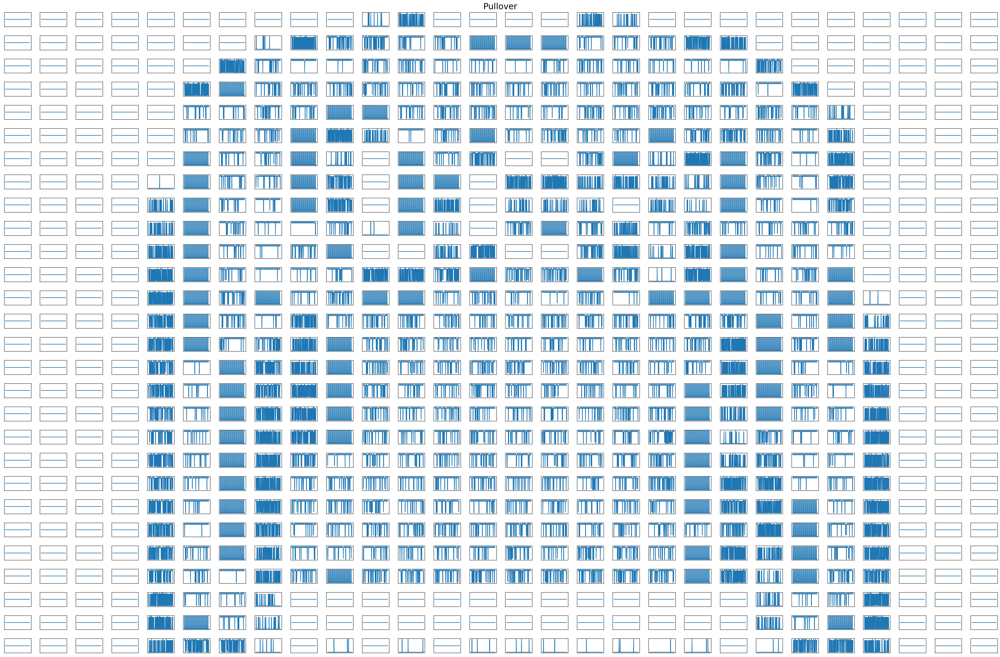

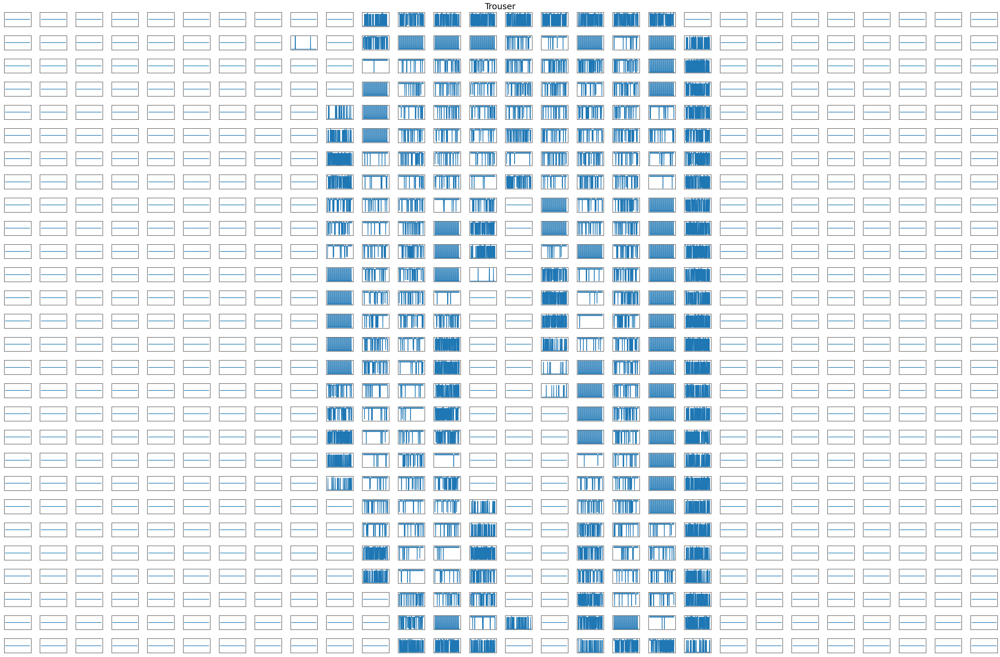

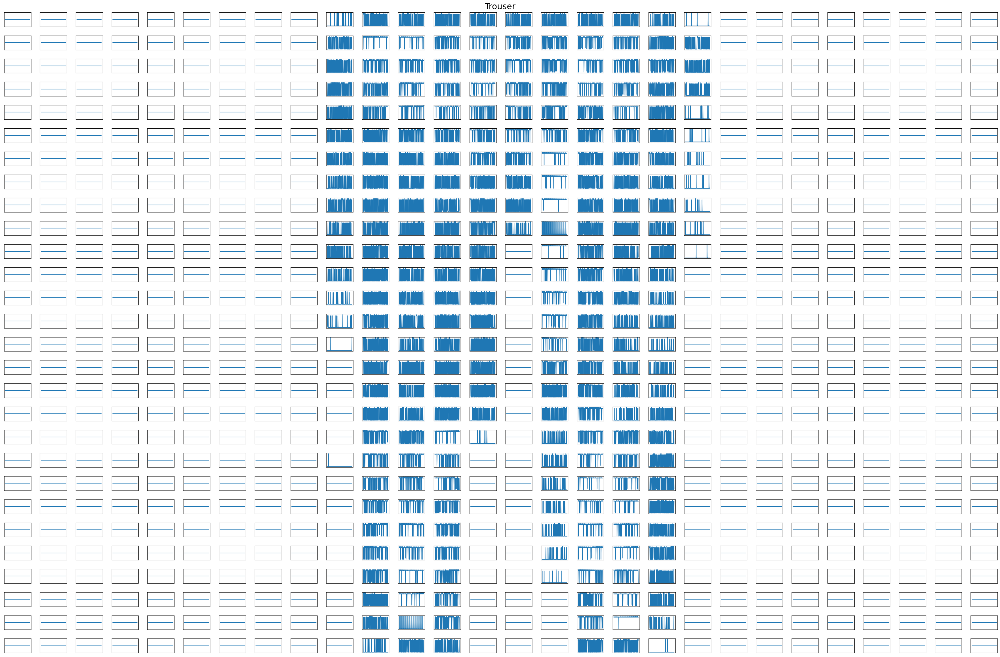

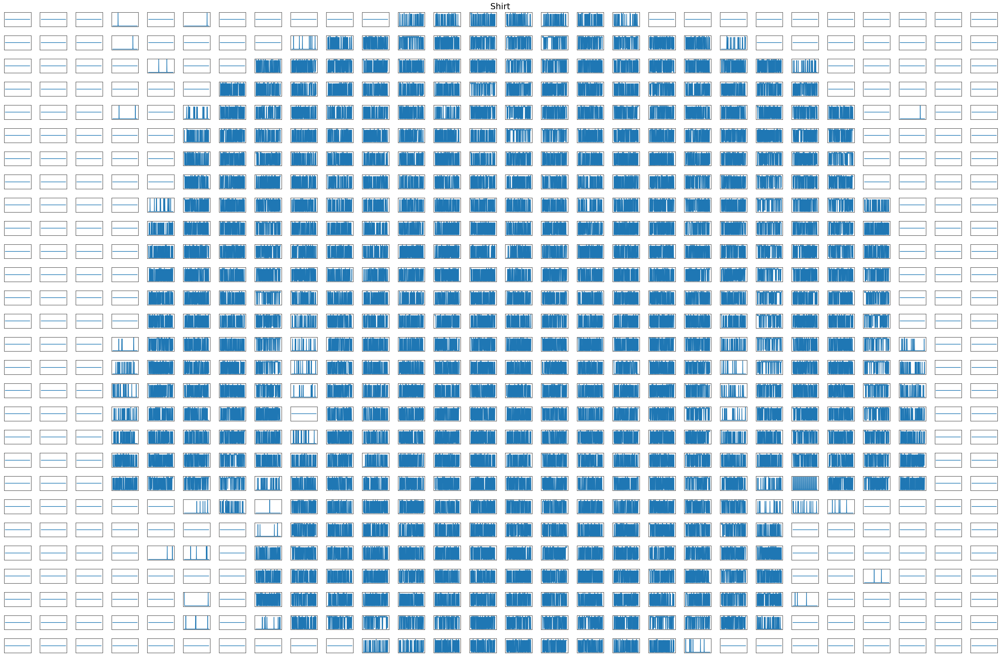

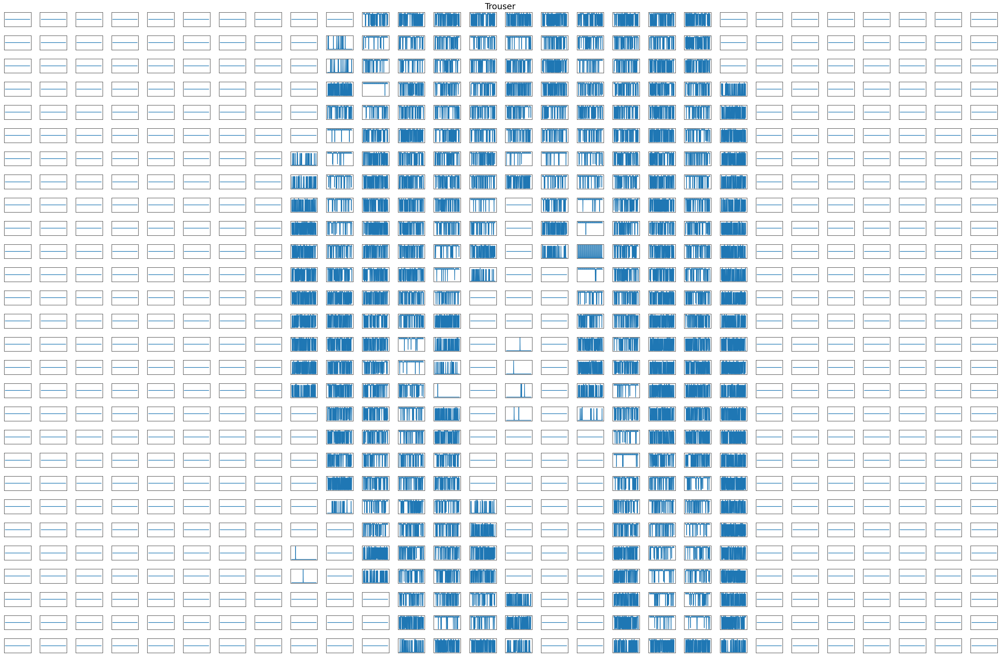

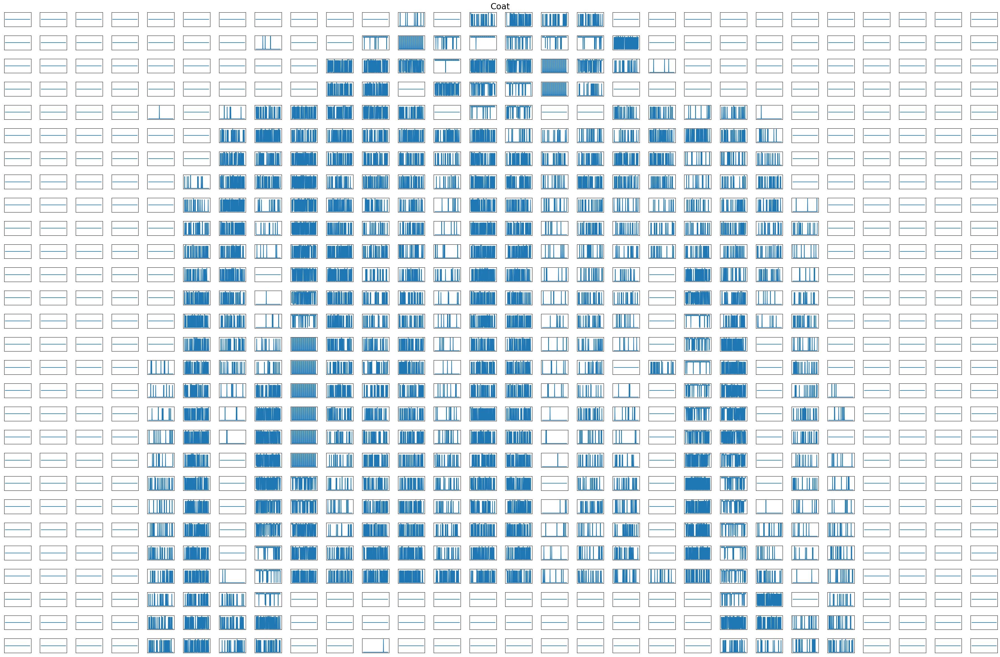

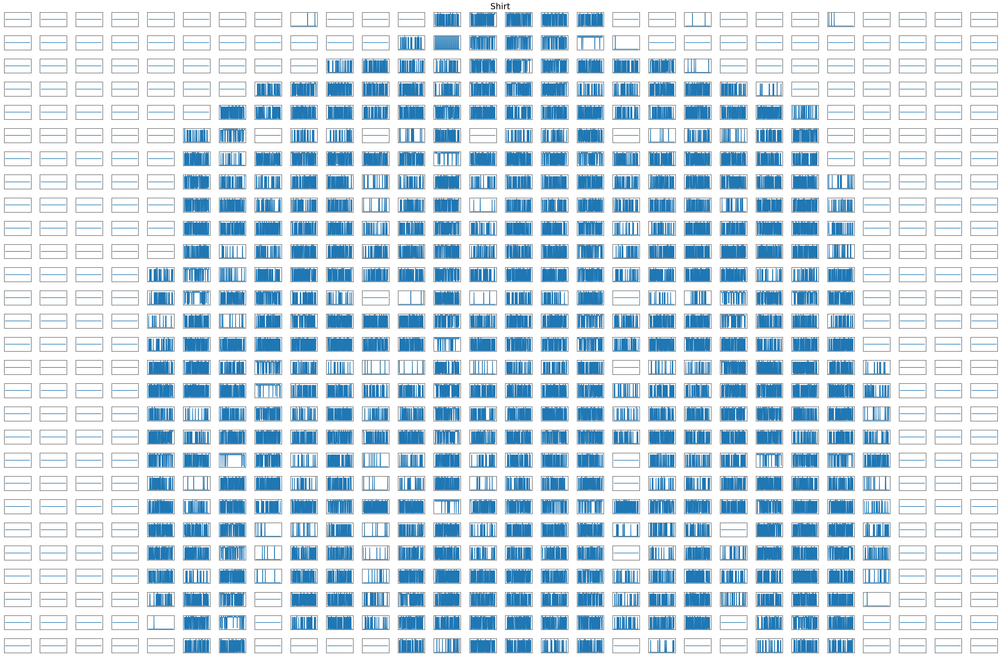

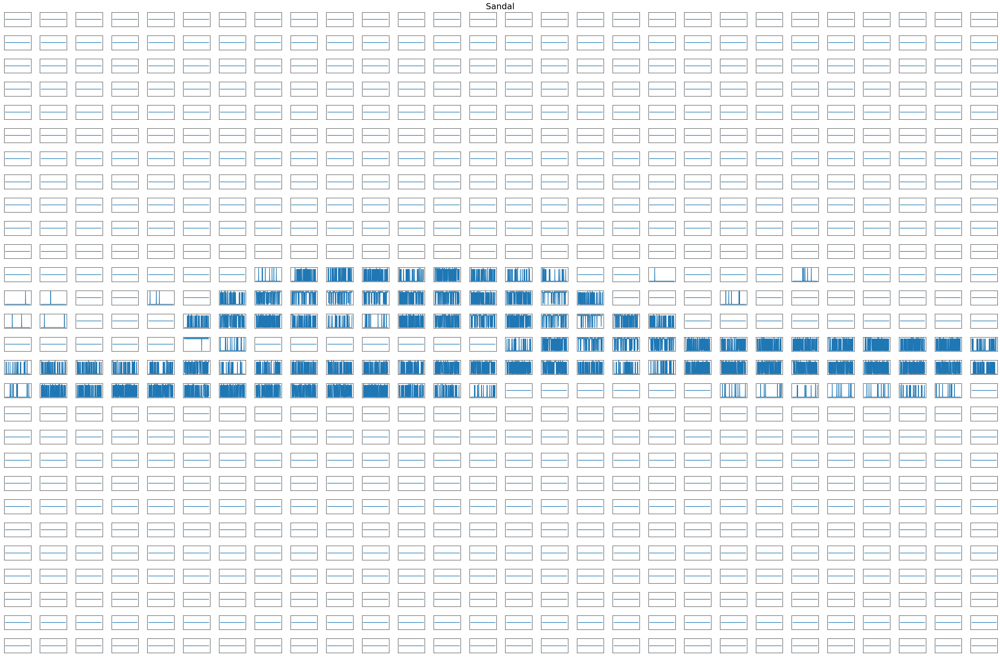

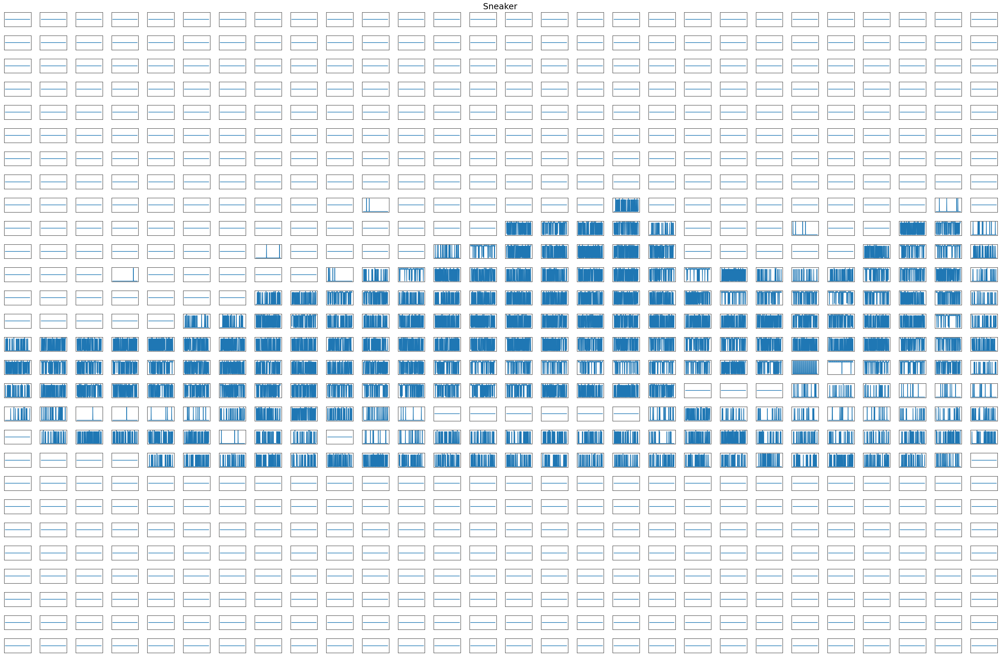

In [11]:
for i in range(0,10):
    datapoint = mem1[:,i]
    fig, axs = plt.subplots(nrows=28,ncols=28)
    fig.set_size_inches(36,24)
    fig.suptitle(target_label[target[i].item()])
    for j in range(0,28):
        for k in range(0,28):
            axs[j][k].set_xticks([], None)
            axs[j][k].set_yticks([], None)
            axs[j][k].plot(torch.arange(0,num_steps), datapoint.squeeze()[:,j,k].detach())

    fig.tight_layout()
    fig.savefig(
        "../figures/rate-coding-FMNIST-membrane-output-full-{}.eps".format(
            target_label[target[i].item()].lower().replace(' ', '-')
        ),
        format='eps'
    )
    fig.savefig(
        "../figures/rate-coding-FMNIST-membrane-output-full-{}.png".format(
            target_label[target[i].item()].lower().replace(' ', '-')
        ),
        format='png'
    )
    plt.show()

## Potenziale di membrana uscita sommata

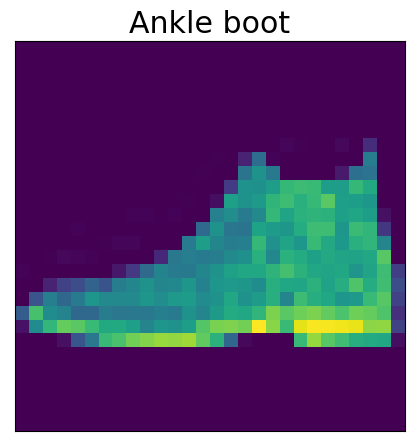

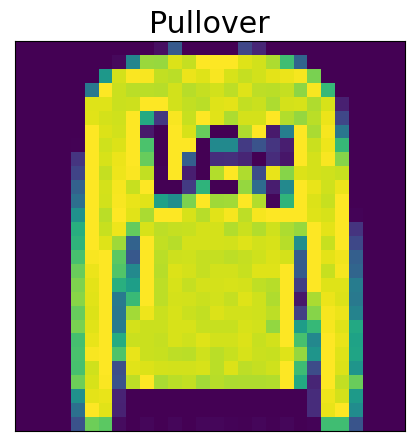

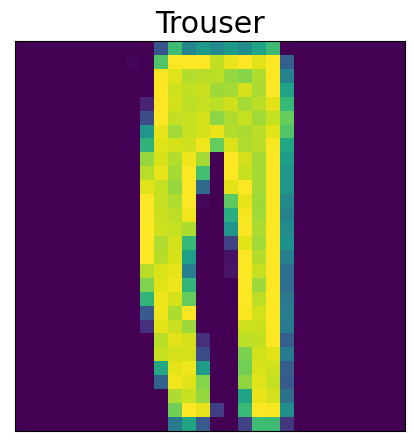

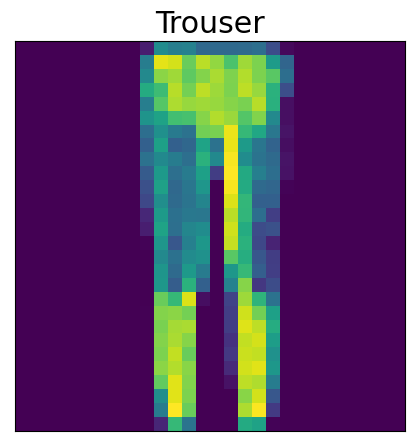

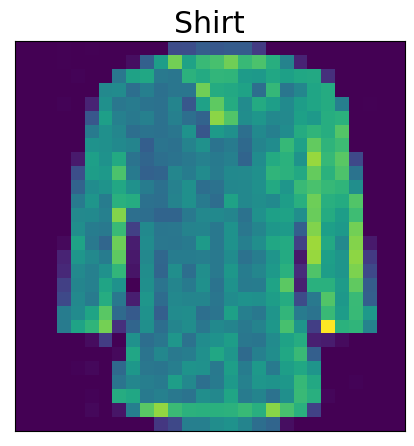

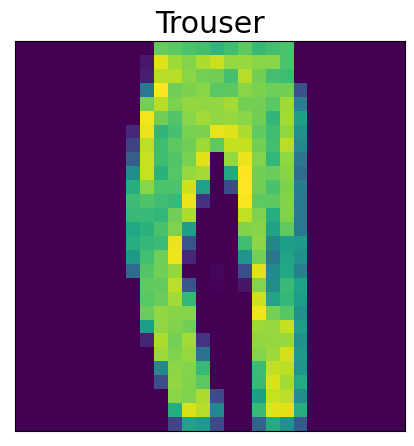

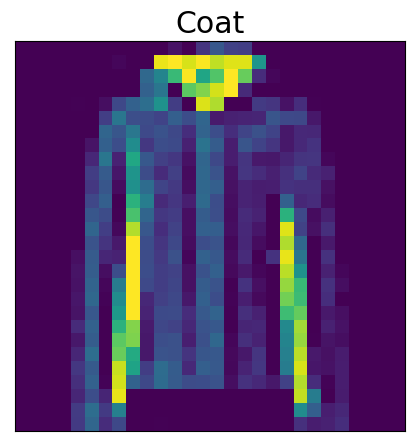

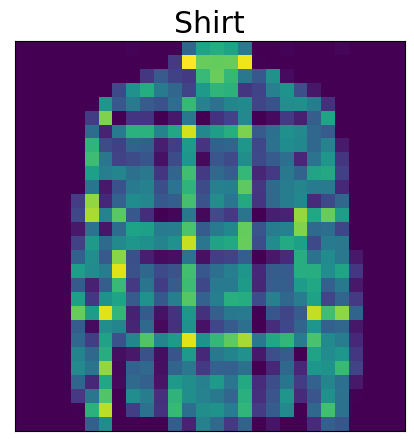

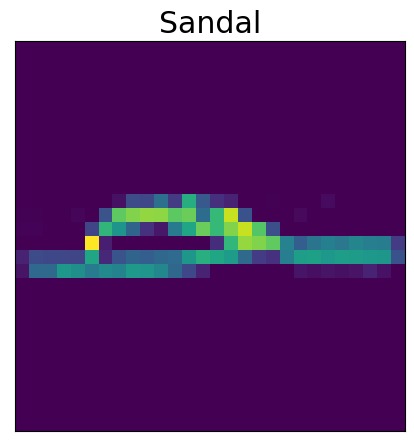

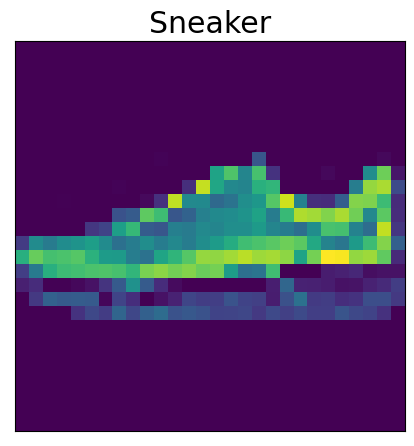

In [12]:
for i in range(0,10):
    datapoint = mem1[:,i]
    summed = torch.sum(datapoint, 0)
    fig, ax = plt.subplots()
    ax.set_xticks([], None)
    ax.set_yticks([], None)
    ax.imshow(summed.squeeze().detach())
    ax.set_title(target_label[target[i].item()])

    fig.tight_layout()
    fig.savefig(
        "../figures/rate-coding-FMNIST-membrane-output-sum-{}.eps".format(
            target_label[target[i].item()].lower().replace(' ','-')
        ),
        format='eps'
    )
    fig.savefig(
        "../figures/rate-coding-FMNIST-membrane-output-sum-{}.png".format(
            target_label[target[i].item()].lower().replace(' ','-')
        ),
        format='png'
    )
    plt.show()

# Rappresentazione degli Spike in uscita

## Video

Ankle boot


Pullover


Trouser


Trouser


Shirt


Trouser


Coat


Shirt


Sandal


Sneaker


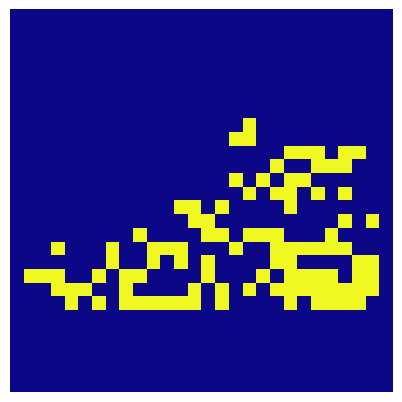

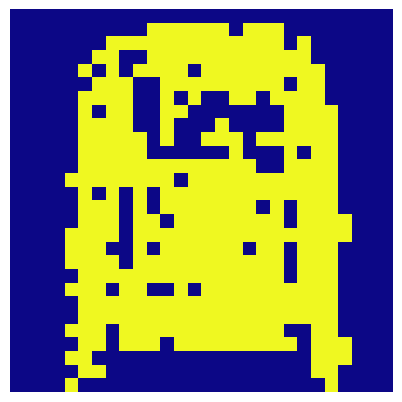

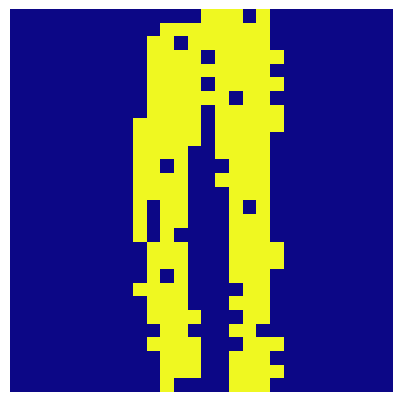

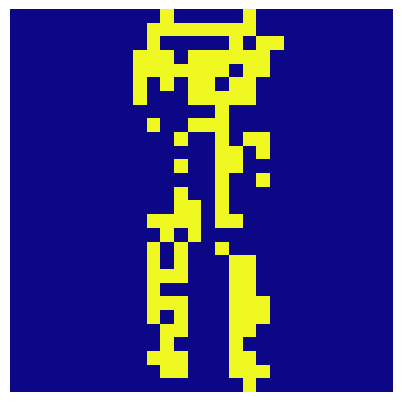

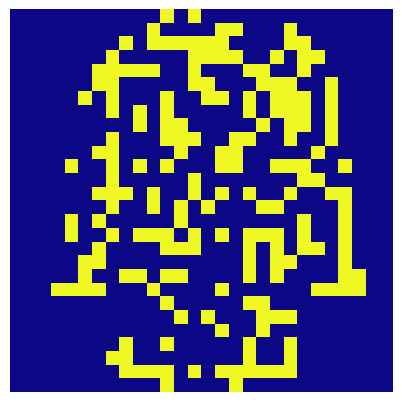

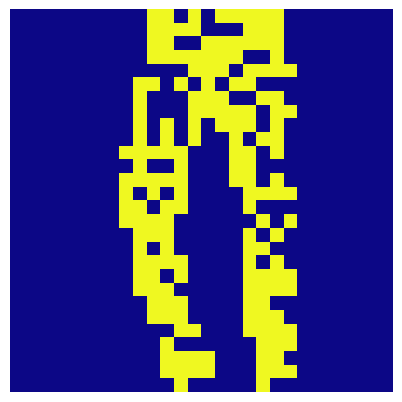

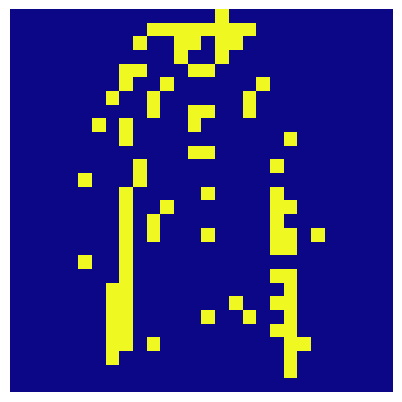

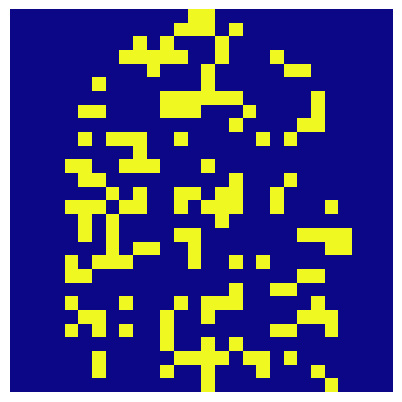

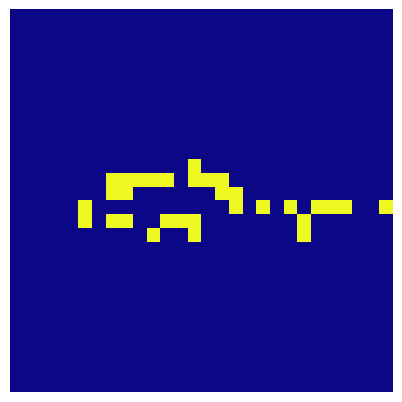

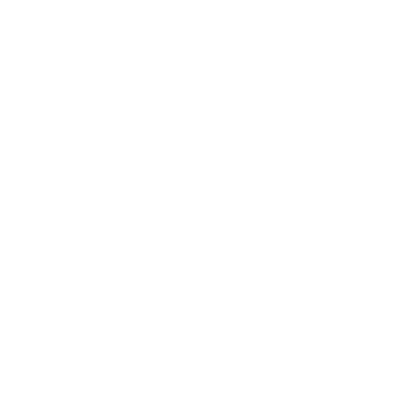

In [13]:
for i in range(0, 10):
    datapoint = spike1[:,i]
    print(target_label[target[i].item()])
    fig, ax = plt.subplots()
    fig.tight_layout()
    anim = splt.animator(datapoint.squeeze().detach(), fig, ax)
    anim.save(
        "../videos/rate-coding-FMNIST-spike-output-video-{}.mp4".format(
        target_label[target[i].item()].lower().replace(' ','-')
        )
    )
    display( HTML( anim.to_html5_video() ) )

## Grafici degli Spike in uscita

### Pixel scelti

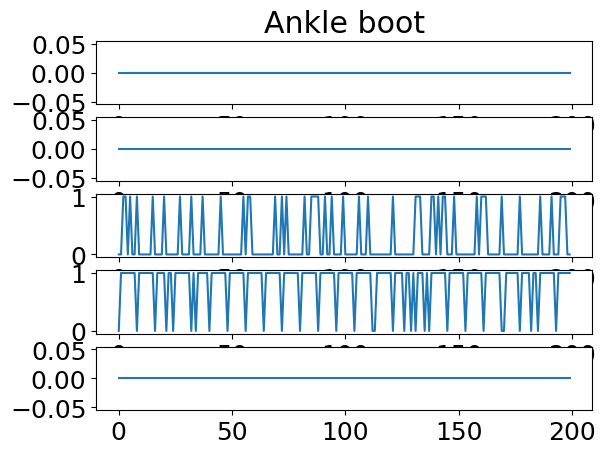

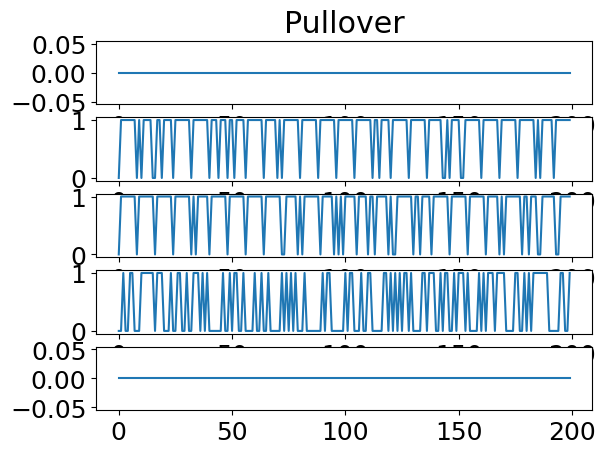

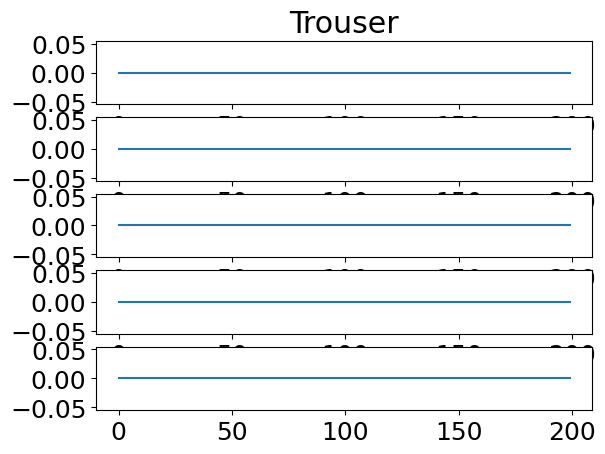

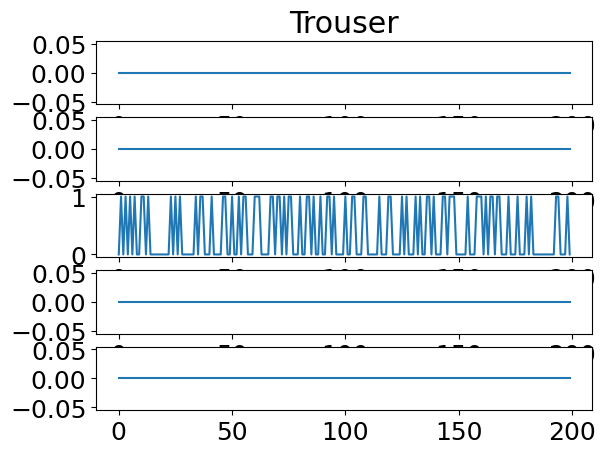

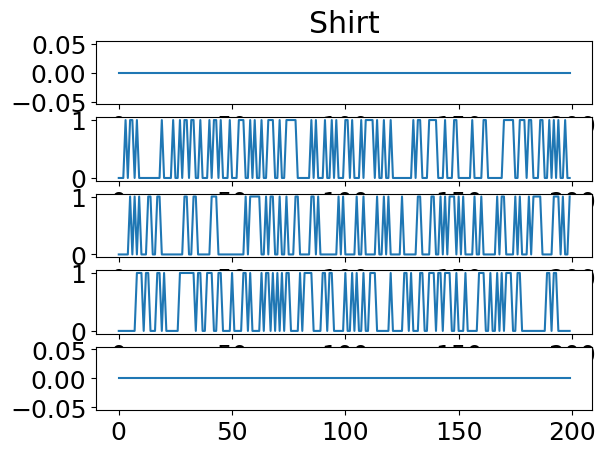

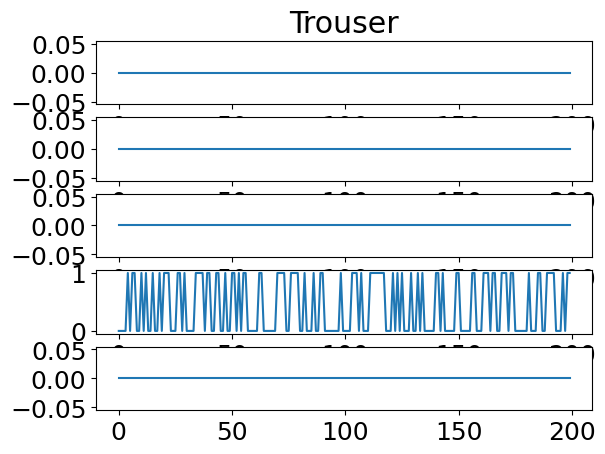

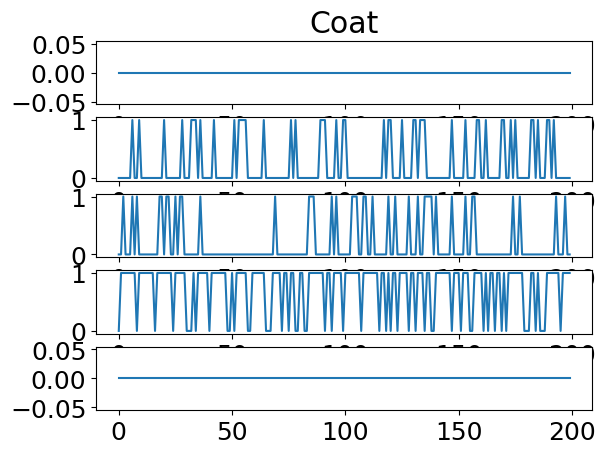

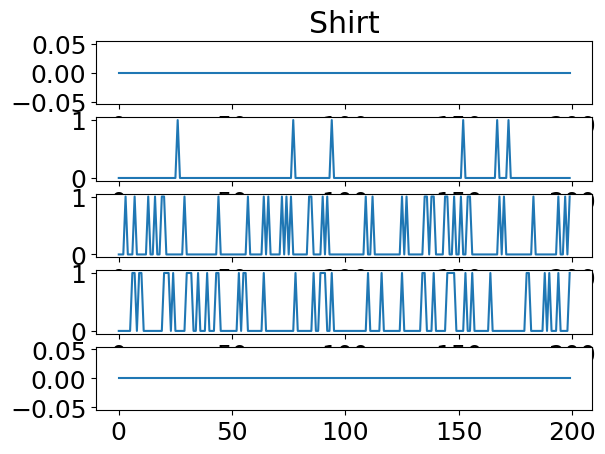

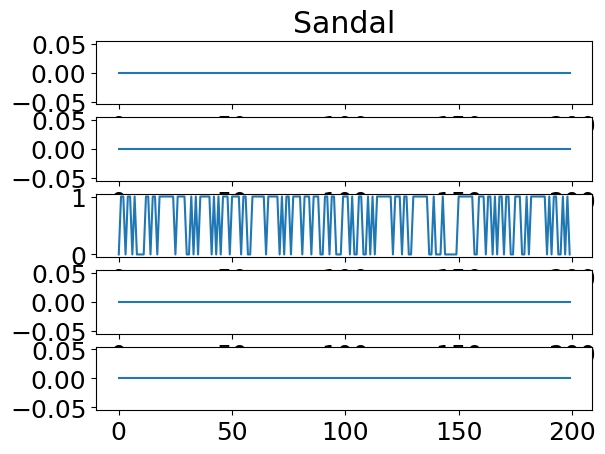

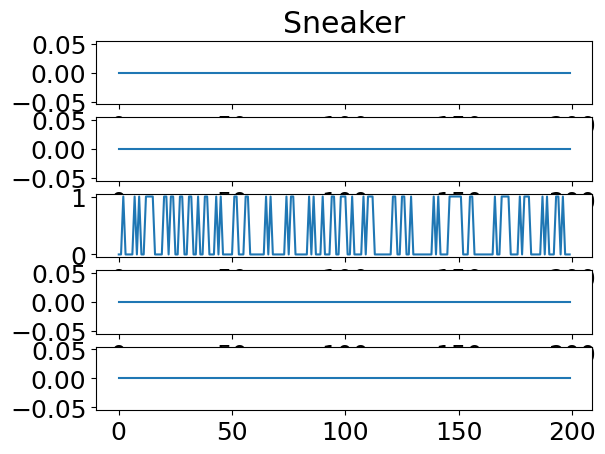

In [14]:
for i in range(0,10):
    datapoint = spike1[:,i]
    fig, axs = plt.subplots(nrows=5)
    axs[0].set_title(target_label[target[i].item()])
    axs[0].plot(torch.arange(0,num_steps), datapoint.squeeze()[:,0,0].detach())
    axs[1].plot(torch.arange(0,num_steps), datapoint.squeeze()[:,6,6].detach())
    axs[2].plot(torch.arange(0,num_steps), datapoint.squeeze()[:,13,13].detach())
    axs[3].plot(torch.arange(0,num_steps), datapoint.squeeze()[:,20,20].detach())
    axs[4].plot(torch.arange(0,num_steps), datapoint.squeeze()[:,27,27].detach())
    fig.savefig(
        "../figures/rate-coding-FMNIST-spike-output-{}.eps".format(
            target_label[target[i].item()].lower().replace(' ','-')
        ),
        format='eps'
    )
    fig.savefig(
        "../figures/rate-coding-FMNIST-spike-output-{}.png".format(
            target_label[target[i].item()].lower().replace(' ','-')
        ),
        format='png'
    )
    plt.show()

### Tutti i pixel

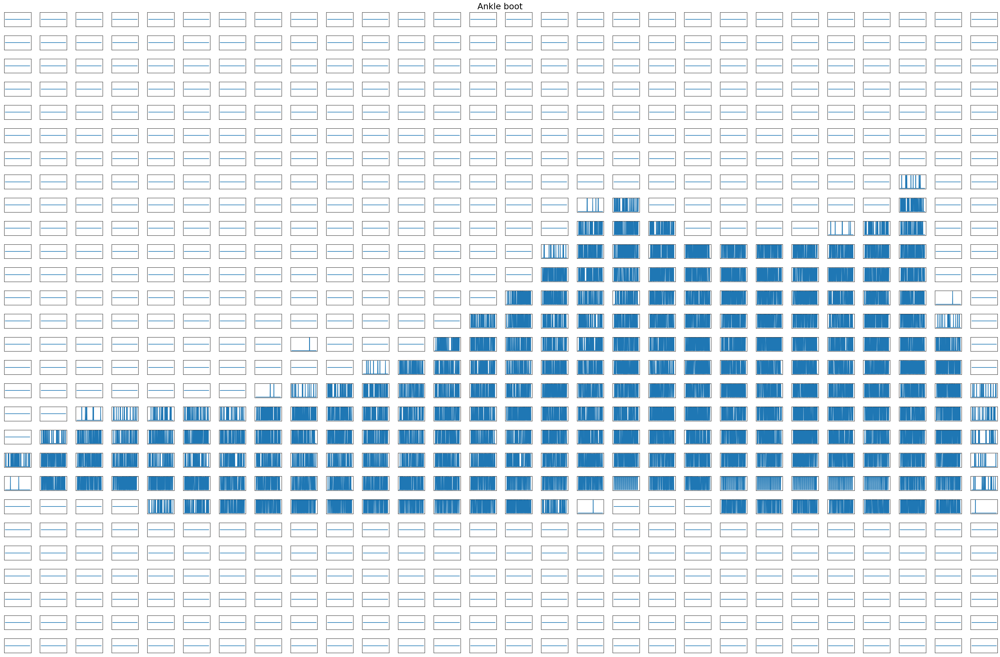

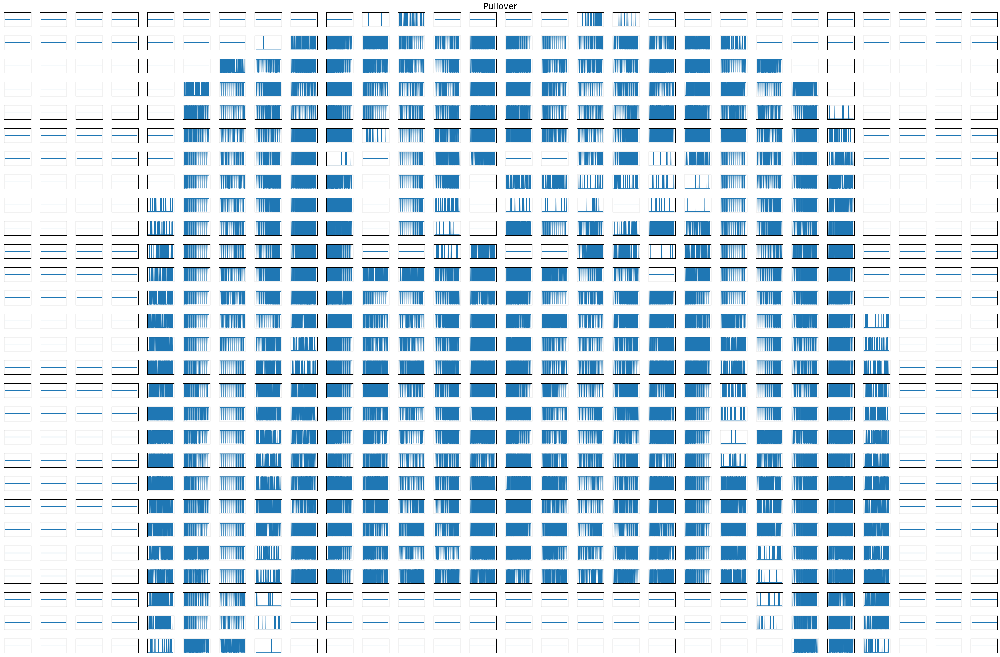

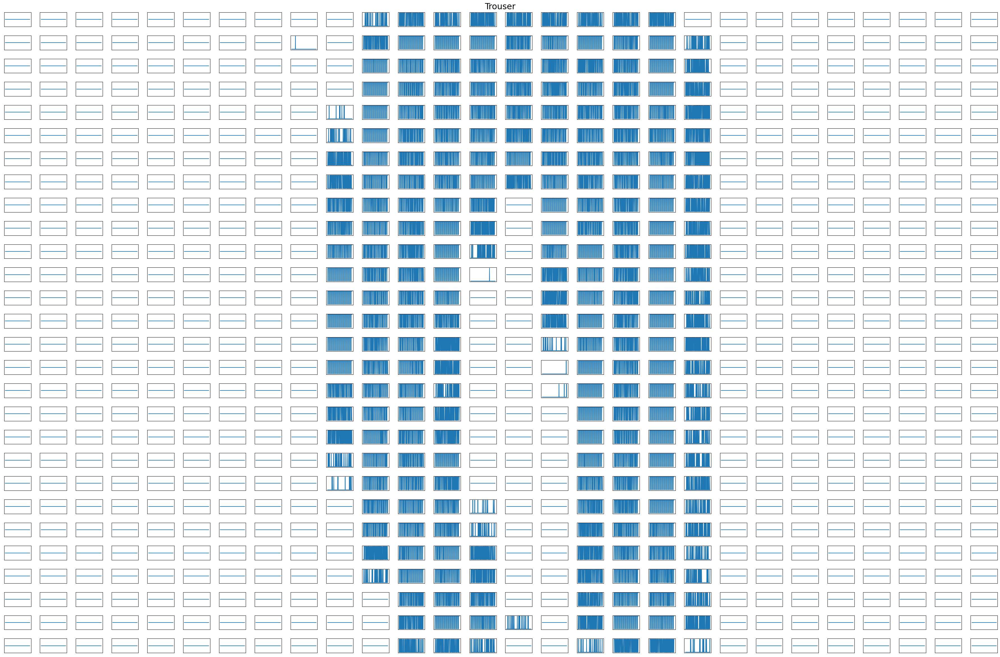

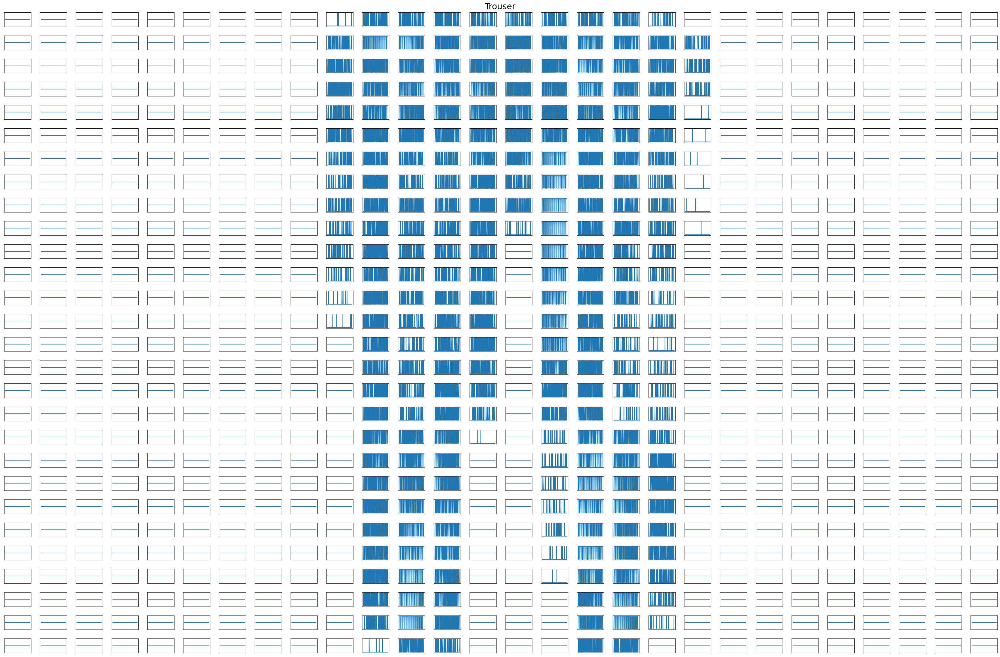

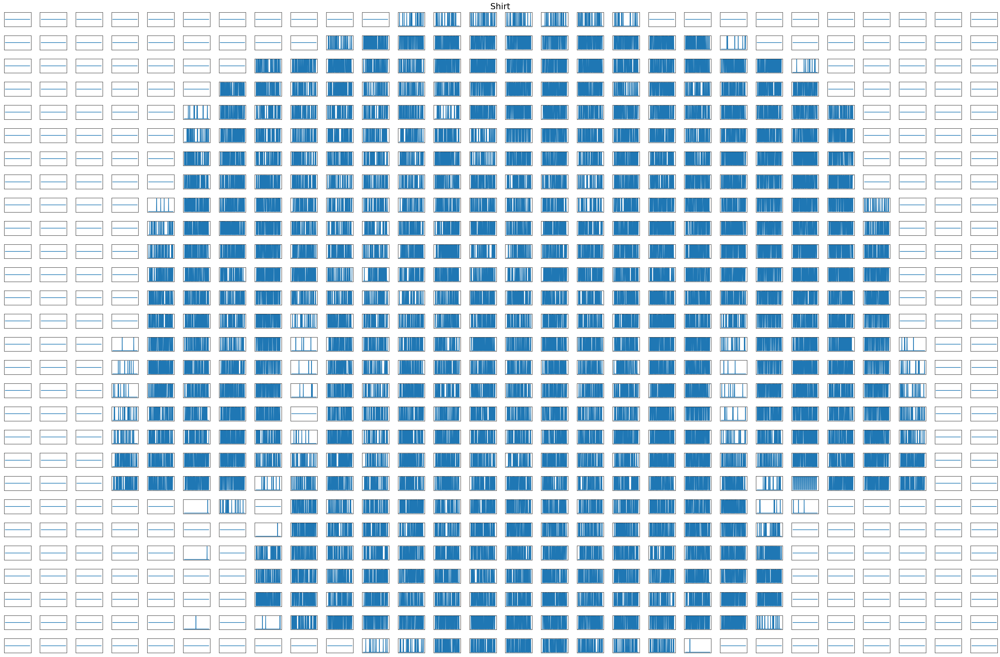

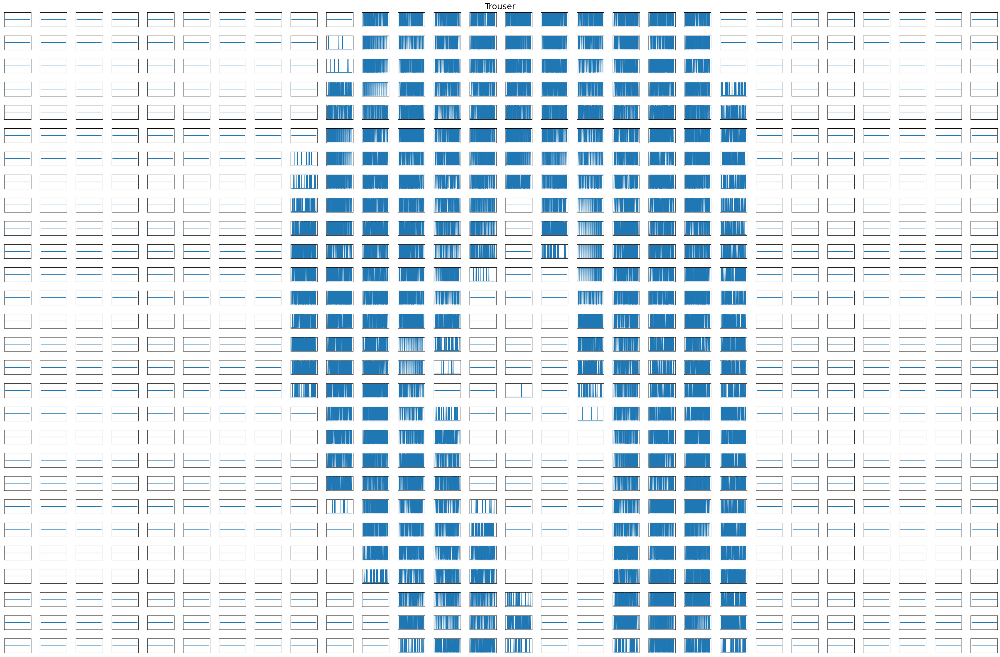

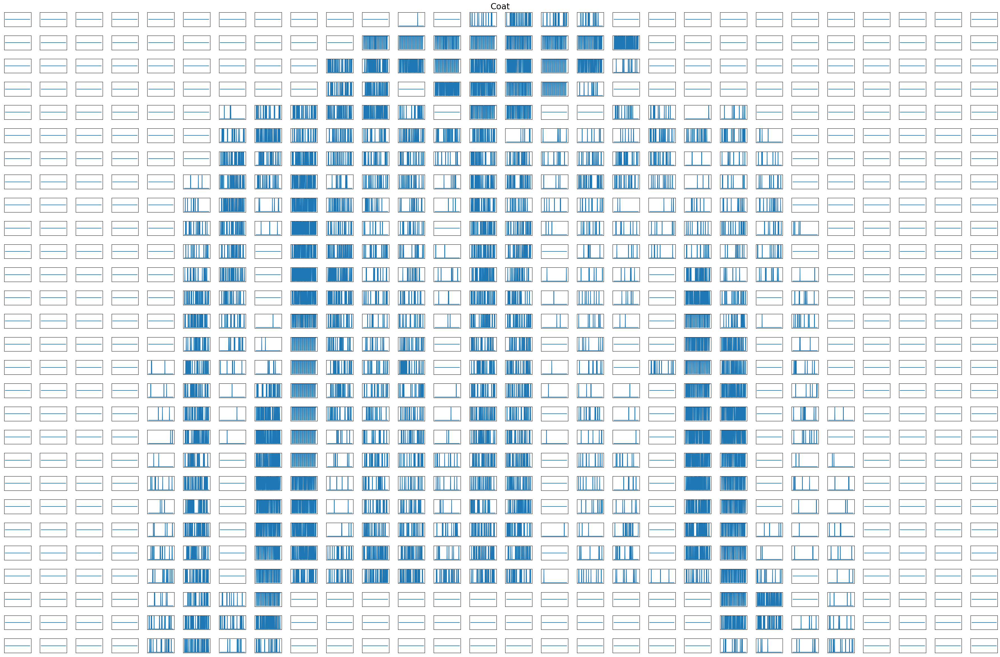

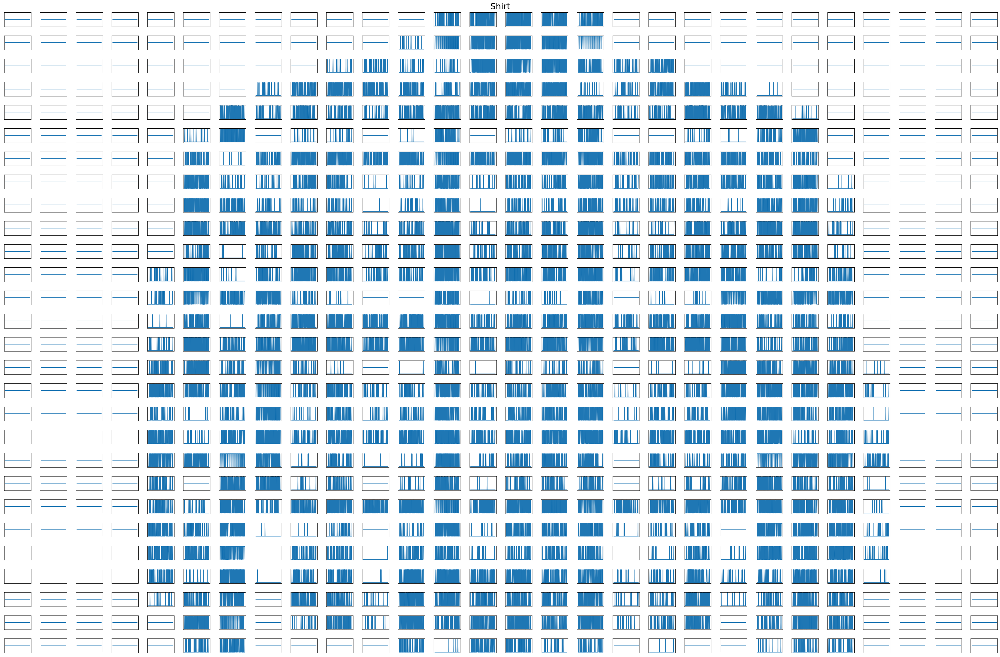

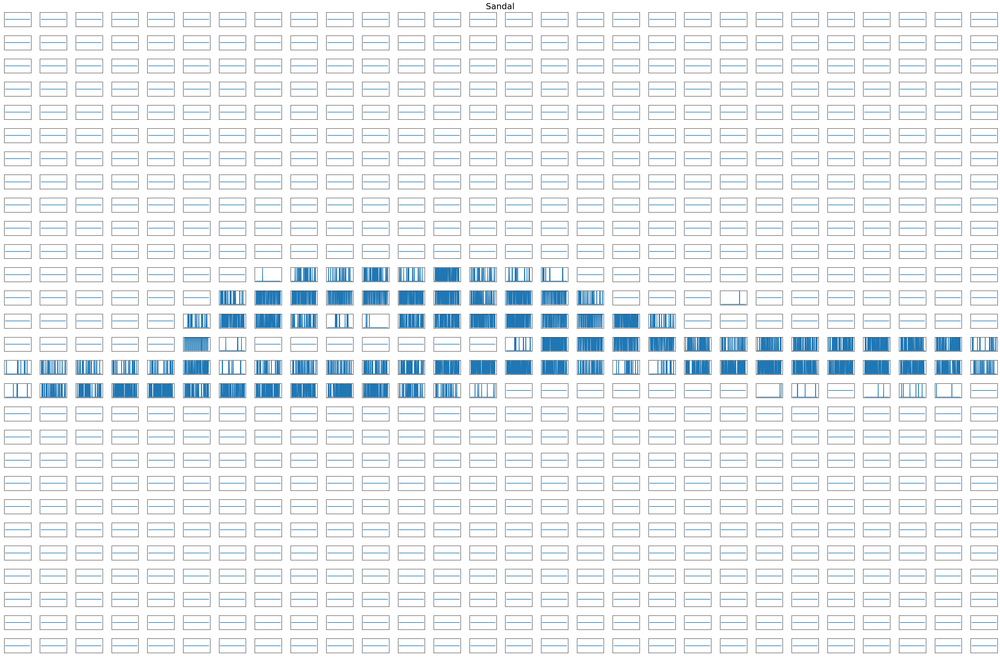

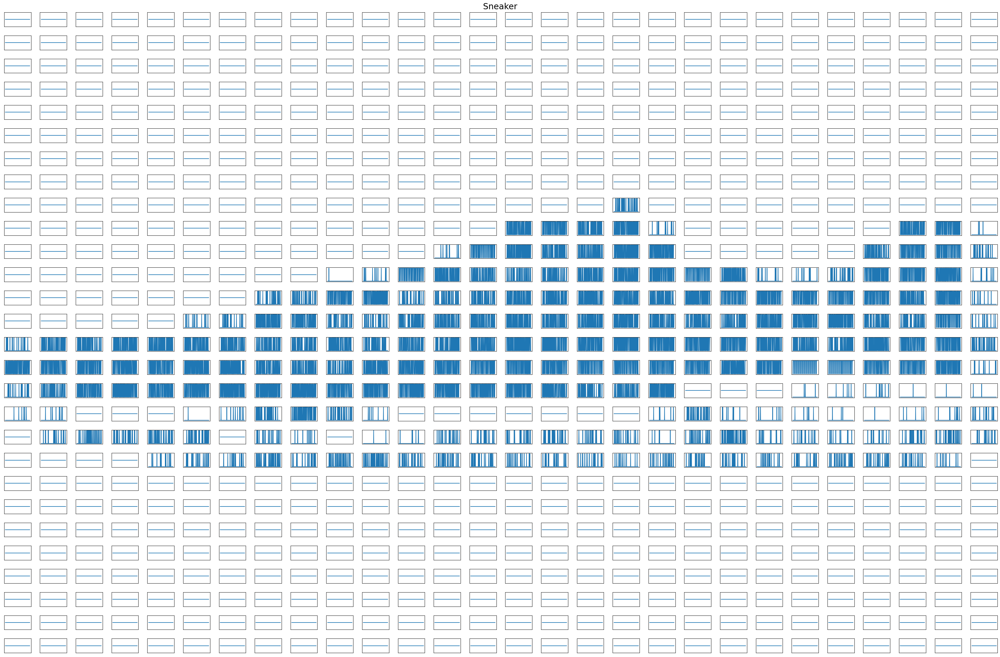

In [15]:
for i in range(0,10):
    datapoint = spike1[:,i]
    fig, axs = plt.subplots(nrows=28,ncols=28)
    fig.set_size_inches(36,24)
    fig.suptitle(target_label[target[i].item()])
    for j in range(0,28):
        for k in range(0,28):
            axs[j][k].set_xticks([], None)
            axs[j][k].set_yticks([], None)
            axs[j][k].plot(torch.arange(0,num_steps), datapoint.squeeze()[:,j,k].detach())

    fig.tight_layout()
    fig.savefig(
        "../figures/rate-coding-FMNIST-spike-output-full-{}.eps".format(
            target_label[target[i].item()].lower().replace(' ','-')
        ),
        format='eps'
    )
    fig.savefig(
        "../figures/rate-coding-FMNIST-spike-output-full-{}.png".format(
            target_label[target[i].item()].lower().replace(' ','-')
        ),
        format='png'
    )
    plt.show()

## Spikes uscita sommata

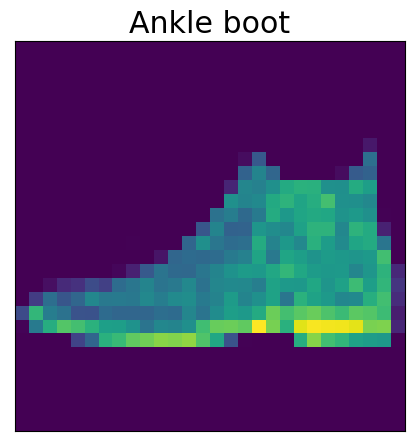

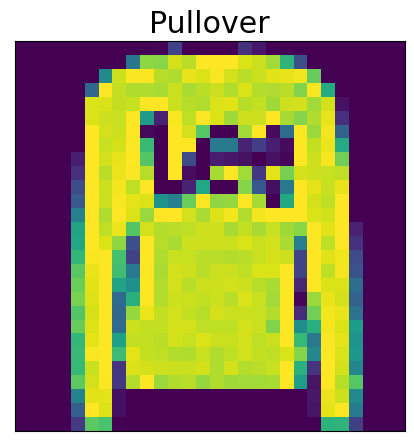

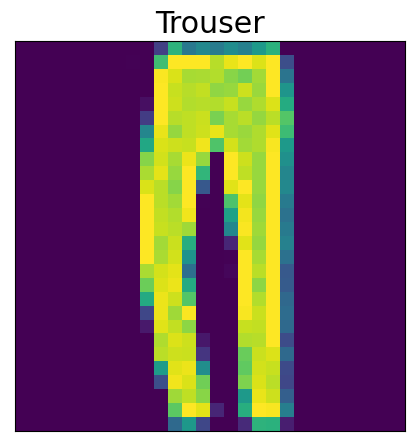

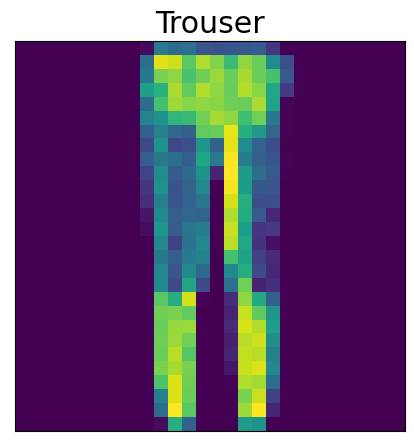

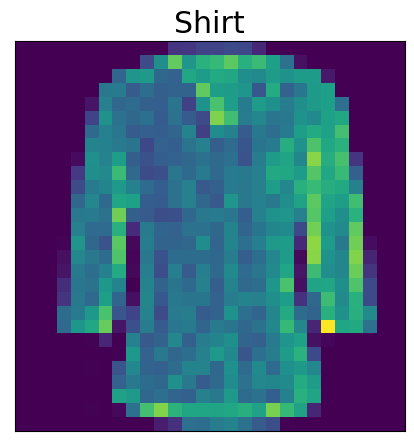

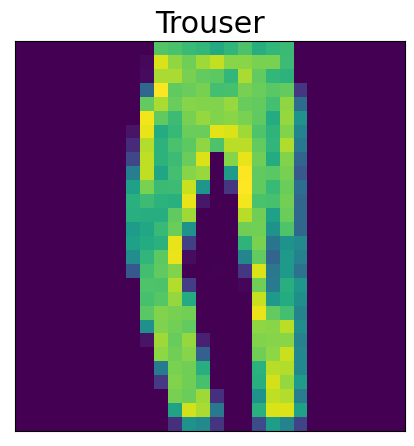

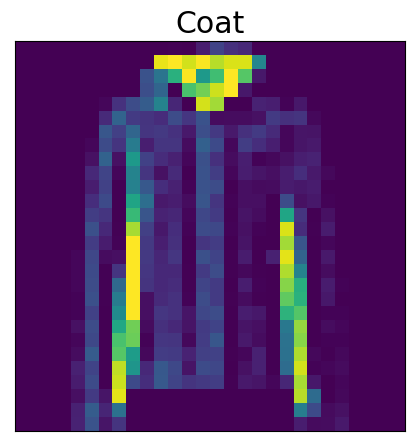

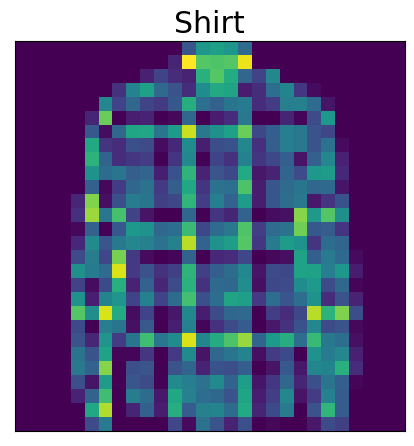

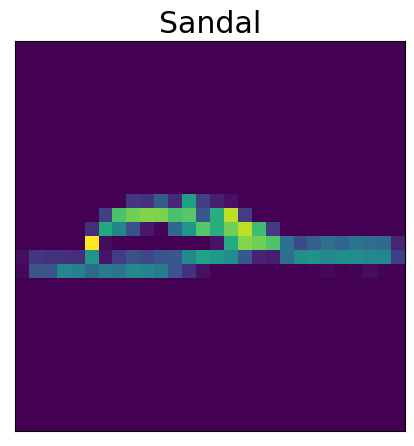

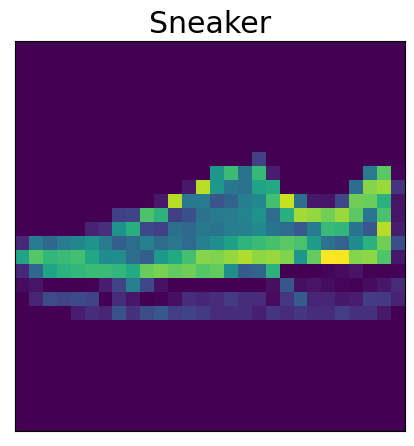

In [16]:
for i in range(0,10):
    datapoint = spike1[:,i]
    summed = torch.sum(datapoint, 0)
    fig, ax = plt.subplots()
    ax.set_title(target_label[target[i].item()])
    ax.set_xticks([], None)
    ax.set_yticks([], None)
    ax.imshow(summed.squeeze().detach())
    fig.tight_layout()
    fig.savefig(
        "../figures/rate-coding-FMNIST-spike-output-sum-{}.eps".format(
            target_label[target[i].item()].lower().replace(' ','-')
        ),
        format='eps'
    )
    fig.savefig(
        "../figures/rate-coding-FMNIST-spike-output-sum-{}.png".format(
            target_label[target[i].item()].lower().replace(' ','-')
        ),
        format='png'
    )
    plt.show()